In [55]:
%reset

# 1. Imports

In [1]:
import mne
import time
import os

import custom_modules.file_handling as  fh
import custom_modules.classification_ptu as clas
import custom_modules.preprocessing_ptu as prep

import importlib
importlib.reload(clas)
importlib.reload(fh)
importlib.reload(prep)

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# 2. Constants

In [2]:
data_path = 'D:/Diplomarbeit_data/eeg/'
# subjects = ['A01', 'A02', 'A03', 'A04', 'A05', 'A06', 'A07' , 'A08', 'A10']
subjects = ['A01', 'A02', 'A03', 'A04', 'A05', 'A06', 'A07' , 'A08', 'A09', 'A10']
trial_type_markers = ['LTR-s', 'LTR-l','RTL-s', 'RTL-l', 'TTB-s', 'TTB-l', 'BTT-s', 'BTT-l']

mne.set_log_level('WARNING') #'INFO' 'WARNING'

In [9]:
# Get source and destination path + create destintation folder if it does not exist.
src_path, dst_path = fh.gen_paths(pth=data_path, src_fldr='2023_04_16_glm_results_cue_aligned_next_shrinkage_approach', dst_fldr='2023_04_16_glm_results_cue_aligned_next_shrinkage_approach')

In [10]:
# Load glm:
# Load bootstrapping matrices:
src = src_path
means = np.load(f'{src}/regr_coeff_global_means.npy')    # .npy extension is added if not given
lowers = np.load(f'{src}/regr_coeff_global_lowers.npy')
uppers = np.load(f'{src}/regr_coeff_global_uppers.npy')

# Save t-test matrices:
stat = np.load(f'{src}/regr_coeff_stats.npy')
p_val = np.load(f'{src}/regr_coeff_pval.npy')

In [11]:
# Load one epochs file:
# Get source and destination path + create destintation folder if it does not exist.
src_path, dst_path = fh.gen_paths(pth=data_path, src_fldr='2023_03_22_epoched_cue_aligned', dst_fldr='2023_04_16_glm_results_cue_aligned_next_shrinkage_approach')
epochs = prep.vis_epochs_for_sbj(src_path, 'A01')

In [12]:
n_chan, n_times = p_val.shape
p_val = p_val
p_extended = p_val.reshape((1,n_chan,n_times))

In [13]:
p_epochs = mne.EpochsArray(p_extended, epochs.info)

C:\Users\peter\AppData\Local\Temp\ipykernel_16160\3768834244.py:2: RuntimeWarning: More than 25 topomaps plots requested. This might take a while.
  fig = p_epochs.average().plot_topomap(times, ch_type='eeg',ncols=7, nrows='auto',scalings=dict(eeg=1), units='a.u.',vlim=(0,1))


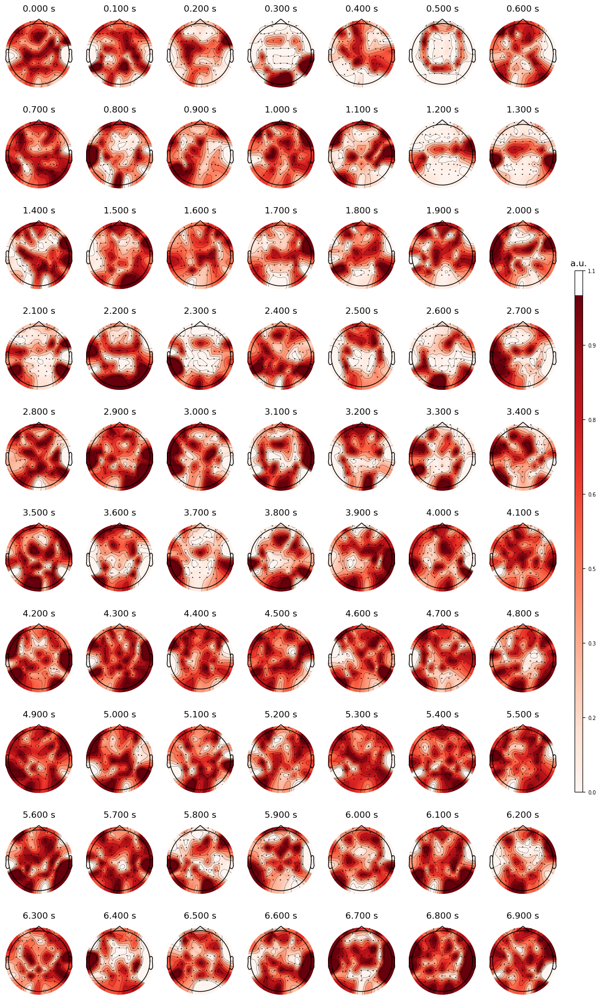

In [14]:
times = np.arange(0.0, 7.0, 0.1)
fig = p_epochs.average().plot_topomap(times, ch_type='eeg',ncols=7, nrows='auto',scalings=dict(eeg=1), units='a.u.',vlim=(0,1))
fig.savefig(f'{dst_path}/topomaps_coefficient_tested_one_sample_t_test_cue_aligned_direction.png', dpi=400)

C:\Users\peter\AppData\Local\Temp\ipykernel_23424\2890521238.py:25: RuntimeWarning: More than 25 topomaps plots requested. This might take a while.
  fig = p_epochs.average().plot_topomap(times, ch_type='eeg', ncols=7, nrows='auto', scalings=dict(eeg=1), units='a.u.', vlim=(0, 1))


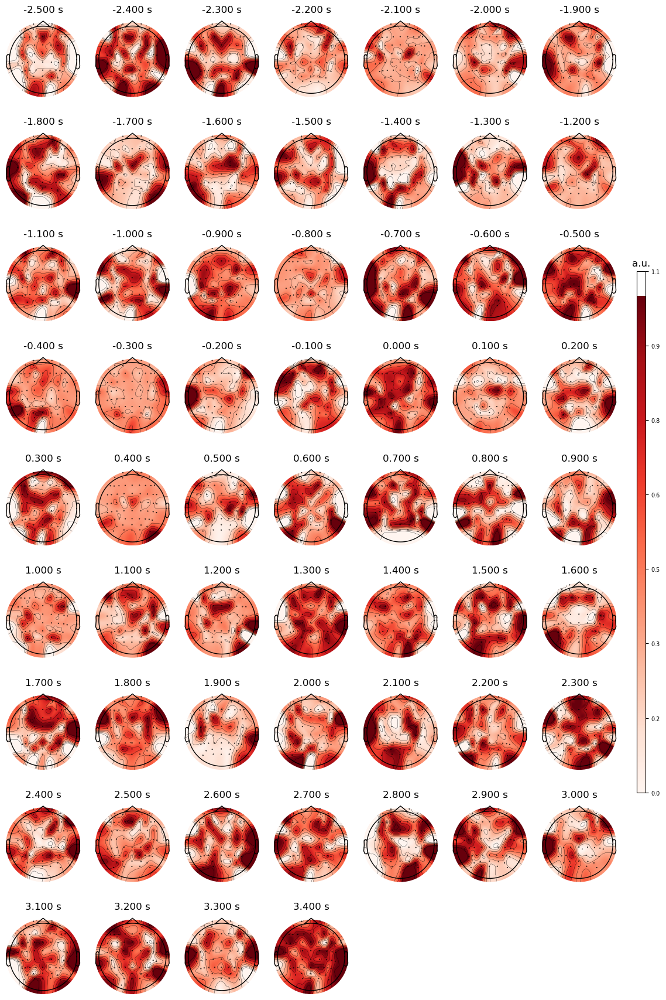

In [95]:
# Get source and destination path + create destintation folder if it does not exist.
src_path, dst_path = fh.gen_paths(pth=data_path, src_fldr='2023_03_22_glm_results_movement_aligned',
                                  dst_fldr='2023_03_22_glm_results_movement_aligned')
# Load glm:
# Load bootstrapping matrices:
src = src_path
means = np.load(f'{src}/regr_coeff_global_means.npy')  # .npy extension is added if not given
lowers = np.load(f'{src}/regr_coeff_global_lowers.npy')
uppers = np.load(f'{src}/regr_coeff_global_uppers.npy')

# Save t-test matrices:
stat = np.load(f'{src}/regr_coeff_stats.npy')
p_val = np.load(f'{src}/regr_coeff_pval.npy')
# Load one epochs file:
# Get source and destination path + create destintation folder if it does not exist.
src_path, dst_path = fh.gen_paths(pth=data_path, src_fldr='2023_03_22_epoched_movement_aligned',
                                  dst_fldr='2023_03_22_glm_results_movement_aligned')
epochs = prep.vis_epochs_for_sbj(src_path, 'A01')

n_chan, n_times = p_val.shape
p_val = p_val
p_extended = p_val.reshape((1, n_chan, n_times))
p_epochs = mne.EpochsArray(p_extended, epochs.info, tmin=epochs.tmin)
times = np.arange(-2.5, 3.5, 0.1)
fig = p_epochs.average().plot_topomap(times, ch_type='eeg', ncols=7, nrows='auto', scalings=dict(eeg=1), units='a.u.', vlim=(0, 1))
fig.savefig(f'{dst_path}/topomaps_coefficient_tested_one_sample_t_test_movement_aligned_direction.png', dpi=400)

# 4. Single channel classification

In [27]:
df = pd.read_csv('dataframes/classification/classification_single_channel_df.csv', index_col=0) # Load dataframe

Calc mean accuracy for each timepoint and for each channel (channel is n_timeopints)

In [30]:
cols = ['Timepoint', 'Mean_accuracy', 'Type', 'N_timepoints']#, 'Upper', 'Lower']
confidence = .95
df_mean = pd.DataFrame(columns=cols)
for n_timepoints in df['N_timepoints'].unique():
    print(f'{n_timepoints}')
    timepoints = df[(df['N_timepoints']==n_timepoints)]['Timepoint'].unique()
    for tp in timepoints:
        # Get average overall subjects for each timepoint:
        accs = np.array(df[(df['N_timepoints'] == n_timepoints) & (df['Timepoint'] == tp)]['Accuracy'])
        mean = accs.mean()

        # Bootstrapping for confidence interval:
        # values = [np.random.choice(accs,size=len(accs),replace=True).mean() for i in range(1000)]
        # lower, upper = np.percentile(values,[100*(1-confidence)/2,100*(1-(1-confidence)/2)])

        df_mean.loc[len(df_mean)] = [tp, mean, type, n_timepoints] #, upper, lower]

df_mean = df_mean.dropna()

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60


Load example epochs for epochs.info and channel dimensions

In [34]:
# Load one epochs file:
# Get source and destination path + create destintation folder if it does not exist.
src_path, dst_path = fh.gen_paths(pth=data_path, src_fldr='2023_03_22_epoched_cue_aligned', dst_fldr='2023_03_22_glm_results_cue_aligned')
epochs = prep.vis_epochs_for_sbj(src_path, 'A01')

ch_names = epochs.ch_names
n_chans = len(ch_names)

Create an n_channels x n_timepoints matrix out of the mean accuracies:

In [38]:
n_timepoints = len(df_mean.Timepoint.unique())
acc_matrix = np.zeros((n_chans,n_timepoints))

Fill the matrix

In [52]:
for chan in range(n_chans):
    for tp in range(n_timepoints):
        acc_matrix[chan,tp] = df_mean[(df_mean['N_timepoints'] == chan) & (df_mean['Timepoint']==tp/10)]['Mean_accuracy']
        # print(df_mean[(df_mean['N_timepoints'] == chan) & (df_mean['Timepoint']==tp/10)]['Mean_accuracy'])

acc_matrix = acc_matrix.reshape((1,n_chans,n_timepoints))

Put it into an epochs structure for the topoplot:

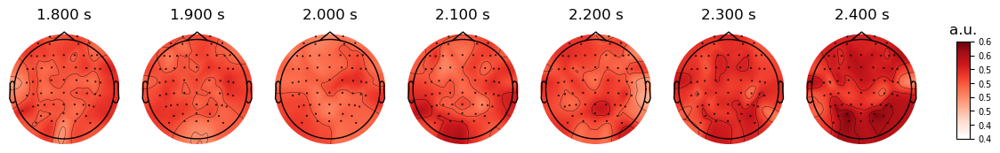

In [57]:
acc_epochs = mne.EpochsArray(acc_matrix, epochs.info)

times = [1.8,1.9,2.0,2.1,2.2,2.3,2.4]
fig = acc_epochs.average().plot_topomap(times, ch_type='eeg',ncols=7, nrows='auto',scalings=dict(eeg=1), units='a.u.',vlim=(0.4,0.6))
# fig.savefig(f'{dst}/topomaps_{title_alignment}_{cond}_{title_cond}.png', dpi=400)

# Statistical tests channel wise

In [54]:
importlib.reload(prep)

# Plot cue-aligned grand average:
src_path, dst_path = fh.gen_paths(pth=data_path, src_fldr='2023_04_11_epoched_cue_aligned_25_resampled', dst_fldr='2023_04_11_results_epoched_cue_aligned_figs_eyesub')

In [38]:
times = np.arange(0.0, 7.0, 0.1)
# list(np.arange(-0.4,1.0,0.1))

p_ls_c = prep.plot_grand_average(src=src_path, dst=dst_path, sbj_list=subjects, paradigm='paradigm', split=['long', 'short'], times=times)
p_ud_c, p_ul_c, p_ur_c, p_dl_c, p_dr_c, p_lr_c = prep.plot_grand_average(src=src_path, dst=dst_path, sbj_list=subjects, paradigm='paradigm', split=['up', 'down', 'left', 'right'], times=times)

Before testing
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
Before testing
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60


In [55]:
file = [f for f in os.listdir(src_path)][0]
epochs = mne.read_epochs(src_path + '/' + file, preload=True)

In [56]:
p_ls_c = np.squeeze(p_ls_c)
p_ud_c = np.squeeze(p_ud_c)
p_ul_c = np.squeeze(p_ul_c)
p_ur_c = np.squeeze(p_ur_c)
p_dl_c = np.squeeze(p_dl_c)
p_dr_c = np.squeeze(p_dr_c)
p_lr_c = np.squeeze(p_lr_c)

In [57]:
# Add column one sample before and one sample after:
times = np.arange(0, 7.0, 0.1)

for t in times:
    samp = int((t - times[0]) * epochs.info['sfreq'])

    if t != times[0]:
        p_ls_c[:, samp-1] = p_ls_c[:, samp]
        p_ud_c[:, samp-1] = p_ud_c[:, samp]
        p_ul_c[:, samp-1] = p_ul_c[:, samp]
        p_ur_c[:, samp-1] = p_ur_c[:, samp]
        p_dl_c[:, samp-1] = p_dl_c[:, samp]
        p_dr_c[:, samp-1] = p_dr_c[:, samp]
        p_lr_c[:, samp-1] = p_lr_c[:, samp]

    if t != times[-1]:
        p_ls_c[:, samp+1] = p_ls_c[:, samp]
        p_ud_c[:, samp+1] = p_ud_c[:, samp]
        p_ul_c[:, samp+1] = p_ul_c[:, samp]
        p_ur_c[:, samp+1] = p_ur_c[:, samp]
        p_dl_c[:, samp+1] = p_dl_c[:, samp]
        p_dr_c[:, samp+1] = p_dr_c[:, samp]
        p_lr_c[:, samp+1] = p_lr_c[:, samp]

In [58]:
n_chan, n_times = p_ls_c.shape
p_ls = p_ls_c.reshape((1, n_chan, n_times))
p_ls_epo = mne.EpochsArray(p_ls, epochs.info, tmin=epochs.tmin)
p_ud = p_ud_c.reshape((1, n_chan, n_times))
p_ud_epo = mne.EpochsArray(p_ud, epochs.info, tmin=epochs.tmin)
p_ul = p_ul_c.reshape((1, n_chan, n_times))
p_ul_epo = mne.EpochsArray(p_ul, epochs.info, tmin=epochs.tmin)
p_ur = p_ur_c.reshape((1, n_chan, n_times))
p_ur_epo = mne.EpochsArray(p_ur, epochs.info, tmin=epochs.tmin)
p_dl = p_dl_c.reshape((1, n_chan, n_times))
p_dl_epo = mne.EpochsArray(p_dl, epochs.info, tmin=epochs.tmin)
p_dr = p_dr_c.reshape((1, n_chan, n_times))
p_dr_epo = mne.EpochsArray(p_dr, epochs.info, tmin=epochs.tmin)
p_lr = p_lr_c.reshape((1, n_chan, n_times))
p_lr_epo = mne.EpochsArray(p_lr, epochs.info, tmin=epochs.tmin)
# times = np.arange(-2.5, 3.5, 1.0)

C:\Users\peter\AppData\Local\Temp\ipykernel_16696\101987325.py:2: RuntimeWarning: More than 25 topomaps plots requested. This might take a while.
  fig = p_ls_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',


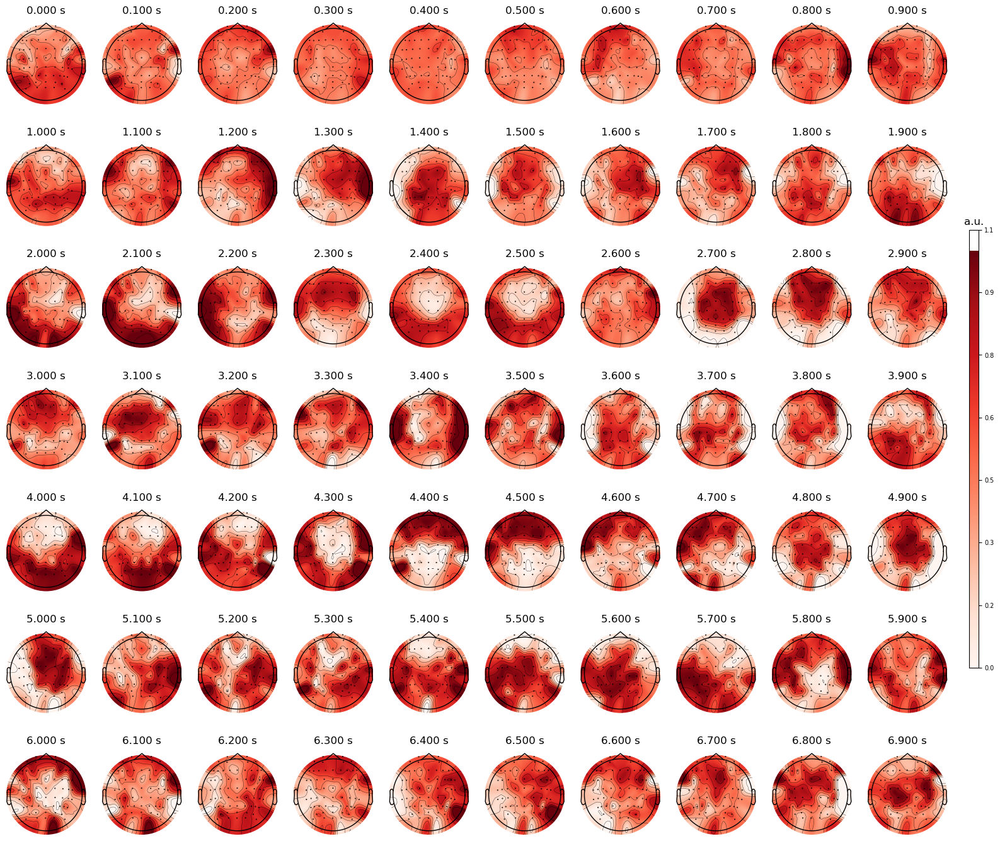

C:\Users\peter\AppData\Local\Temp\ipykernel_16696\101987325.py:6: RuntimeWarning: More than 25 topomaps plots requested. This might take a while.
  fig = p_ud_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',


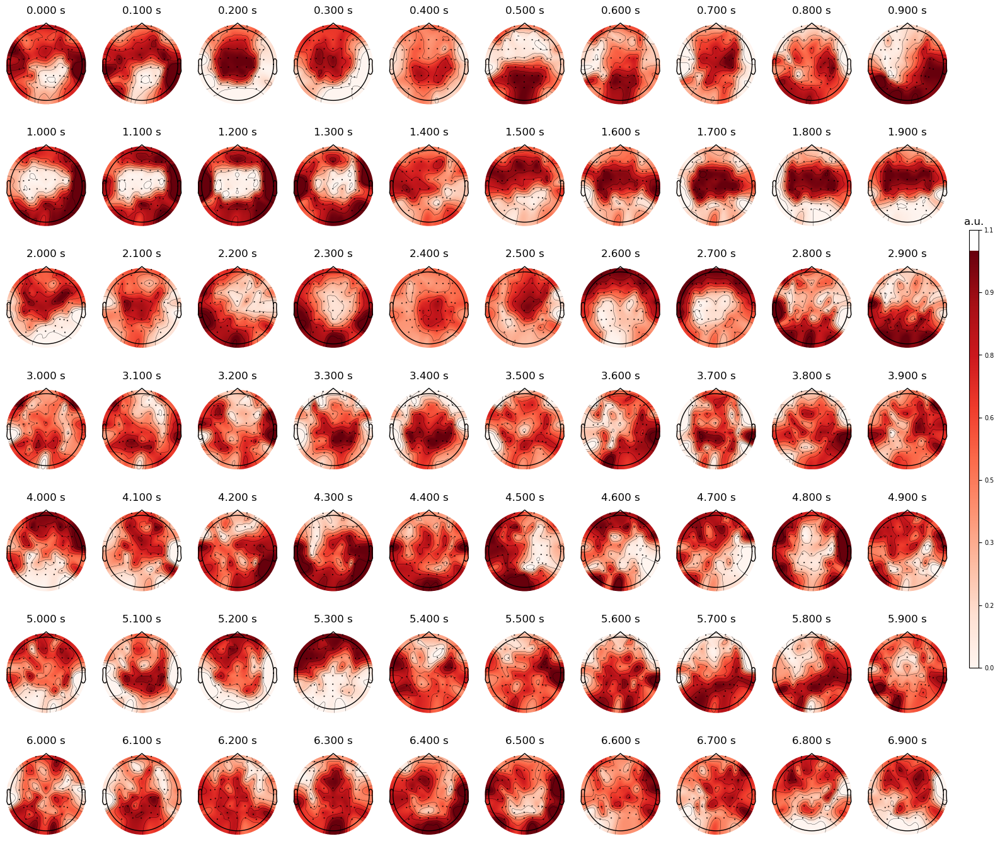

C:\Users\peter\AppData\Local\Temp\ipykernel_16696\101987325.py:10: RuntimeWarning: More than 25 topomaps plots requested. This might take a while.
  fig = p_ul_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',


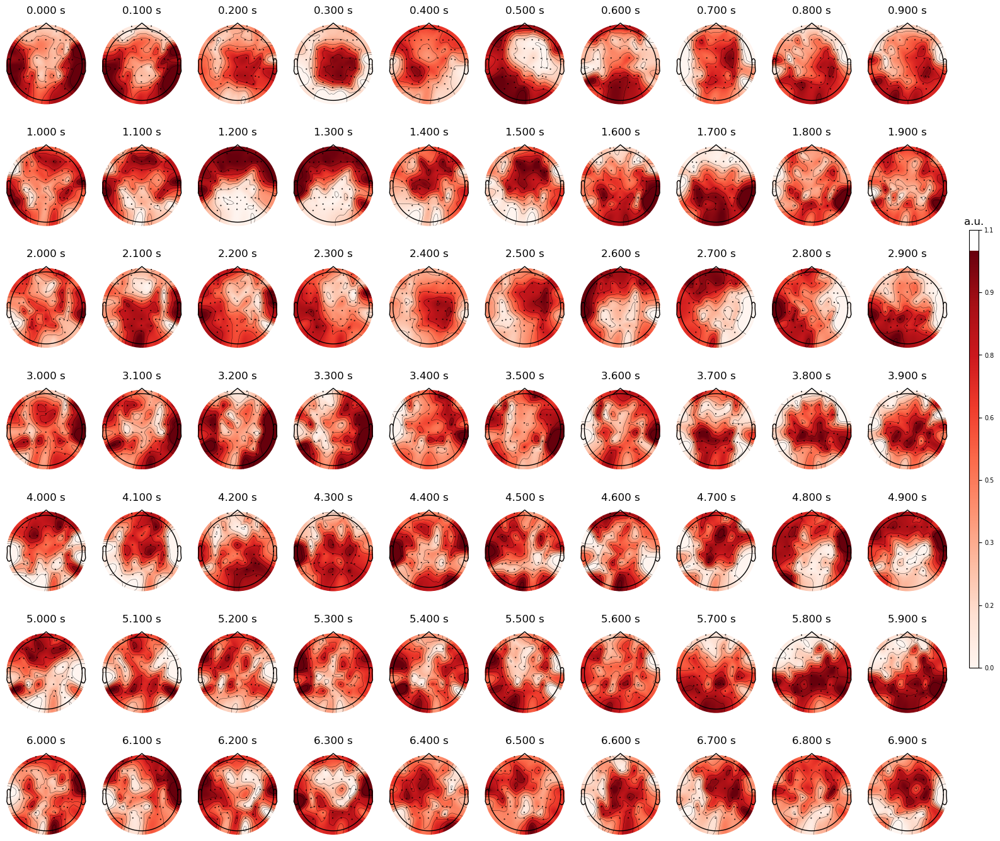

C:\Users\peter\AppData\Local\Temp\ipykernel_16696\101987325.py:14: RuntimeWarning: More than 25 topomaps plots requested. This might take a while.
  fig = p_ur_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',


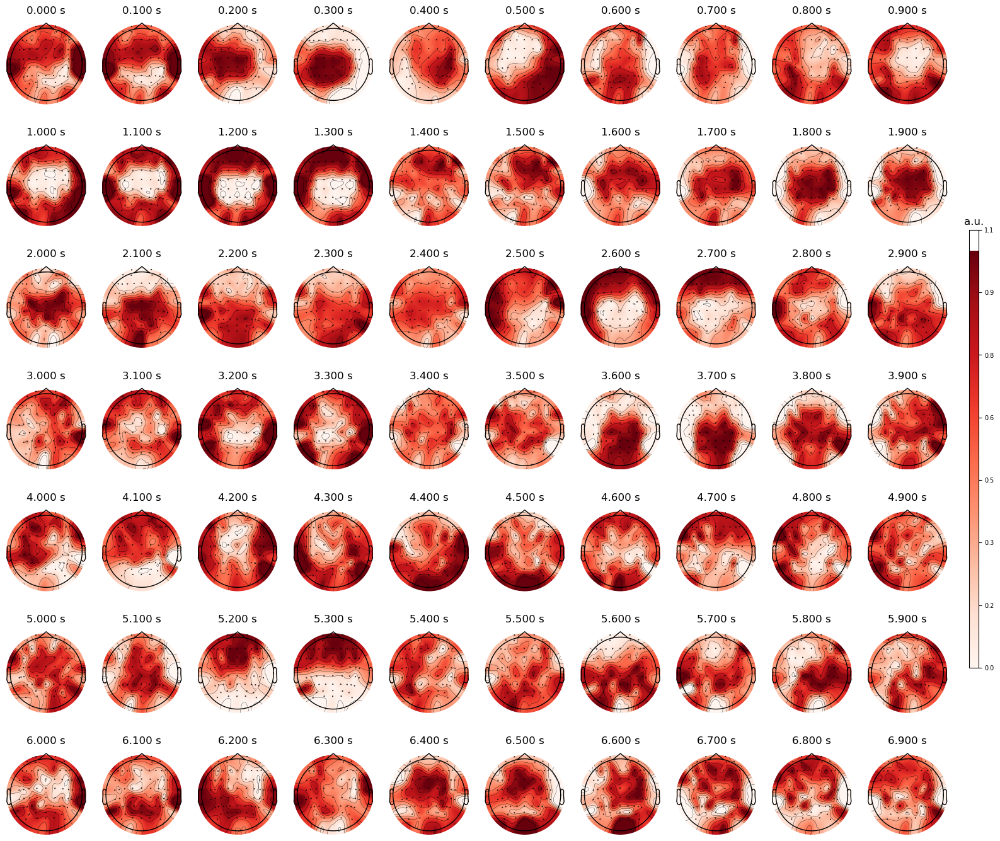

C:\Users\peter\AppData\Local\Temp\ipykernel_16696\101987325.py:18: RuntimeWarning: More than 25 topomaps plots requested. This might take a while.
  fig = p_dl_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',


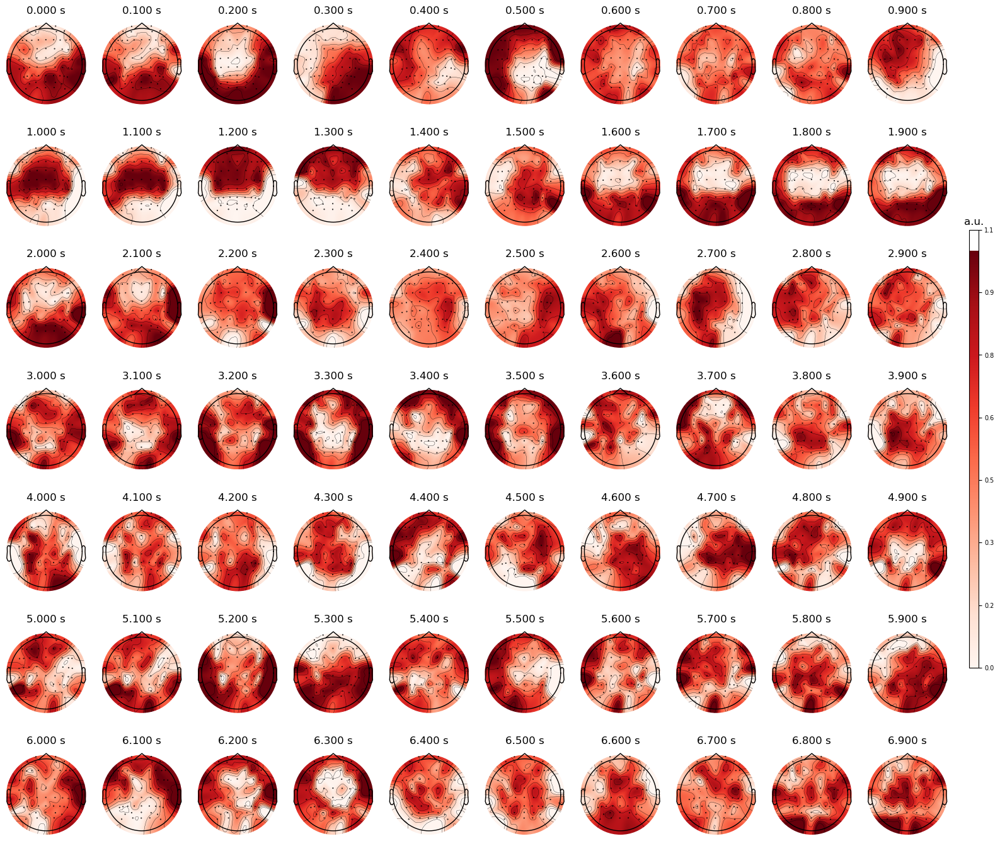

C:\Users\peter\AppData\Local\Temp\ipykernel_16696\101987325.py:22: RuntimeWarning: More than 25 topomaps plots requested. This might take a while.
  fig = p_dr_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',


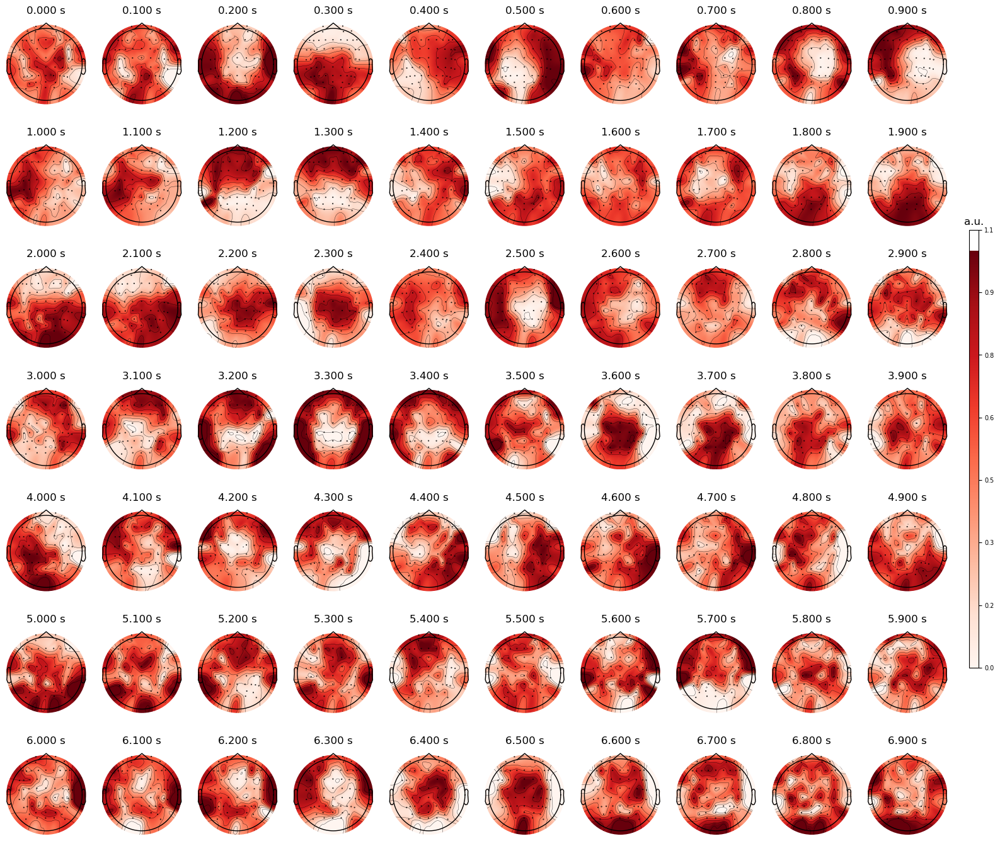

C:\Users\peter\AppData\Local\Temp\ipykernel_16696\101987325.py:26: RuntimeWarning: More than 25 topomaps plots requested. This might take a while.
  fig = p_lr_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',


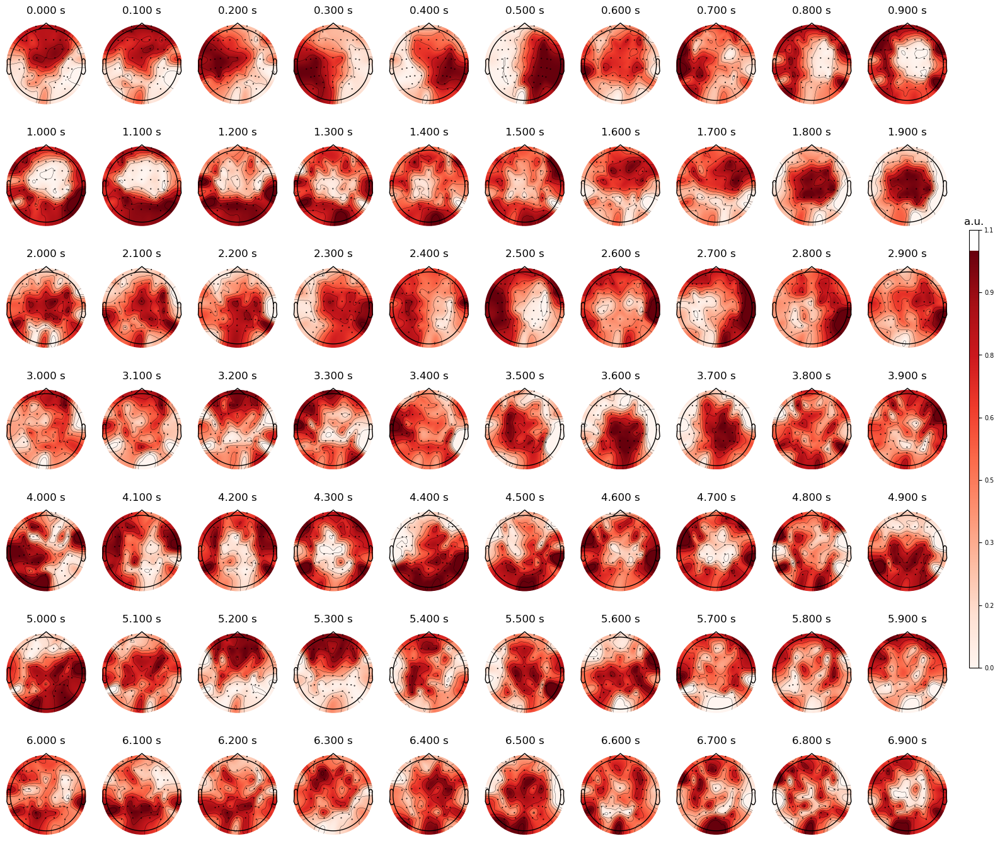

In [59]:
names = ['long_short', 'up_down', 'up_left', 'up_right', 'down_left', 'down_right', 'left_right']
fig = p_ls_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',
                                      vlim=(0, 1))
fig.savefig(f'{dst_path}/topomaps_combination_tested_{names[0]}_cue_aligned.png', dpi=400)

fig = p_ud_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',
                                      vlim=(0, 1))
fig.savefig(f'{dst_path}/topomaps_combination_tested_{names[1]}_cue_aligned.png', dpi=400)

fig = p_ul_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',
                                      vlim=(0, 1))
fig.savefig(f'{dst_path}/topomaps_combination_tested_{names[2]}_cue_aligned.png', dpi=400)

fig = p_ur_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',
                                      vlim=(0, 1))
fig.savefig(f'{dst_path}/topomaps_combination_tested_{names[3]}_cue_aligned.png', dpi=400)

fig = p_dl_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',
                                      vlim=(0, 1))
fig.savefig(f'{dst_path}/topomaps_combination_tested_{names[4]}_cue_aligned.png', dpi=400)

fig = p_dr_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',
                                      vlim=(0, 1))
fig.savefig(f'{dst_path}/topomaps_combination_tested_{names[5]}_cue_aligned.png', dpi=400)

fig = p_lr_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',
                                      vlim=(0, 1))
fig.savefig(f'{dst_path}/topomaps_combination_tested_{names[6]}_cue_aligned.png', dpi=400)

## Movement-aligned

In [43]:
importlib.reload(prep)

# Plot cue-aligned grand average:
src_path, dst_path = fh.gen_paths(pth=data_path, src_fldr='2023_04_11_epoched_movement_aligned_25_resampled', dst_fldr='2023_04_11_results_epoched_movement_aligned_figs_eyesub')

In [44]:
times = np.arange(-2.5, 3.5, 0.1)
# list(np.arange(-0.4,1.0,0.1))

p_ls = prep.plot_grand_average(src=src_path, dst=dst_path, sbj_list=subjects, paradigm='paradigm', split=['long', 'short'], times=times)
p_ud, p_ul, p_ur, p_dl, p_dr, p_lr = prep.plot_grand_average(src=src_path, dst=dst_path, sbj_list=subjects, paradigm='paradigm', split=['up', 'down', 'left', 'right'], times=times)

Before testing
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
Before testing
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60


In [45]:
file = [f for f in os.listdir(src_path)][0]
epochs = mne.read_epochs(src_path + '/' + file, preload=True)

In [46]:
# Add column one sample before and one sample after:
times = np.arange(-2.5, 3.5, 0.1)

for t in times:
    samp = int((t - times[0]) * epochs.info['sfreq'])

    if t != times[0]:
        p_ls[:, samp-1] = p_ls[:, samp]
        p_ud[:, samp-1] = p_ud[:, samp]
        p_ul[:, samp-1] = p_ul[:, samp]
        p_ur[:, samp-1] = p_ur[:, samp]
        p_dl[:, samp-1] = p_dl[:, samp]
        p_dr[:, samp-1] = p_dr[:, samp]
        p_lr[:, samp-1] = p_lr[:, samp]


In [47]:
n_chan, n_times = p_ls.shape
p_ls = p_ls.reshape((1, n_chan, n_times))
p_ls_epo = mne.EpochsArray(p_ls, epochs.info, tmin=epochs.tmin)
p_ud = p_ud.reshape((1, n_chan, n_times))
p_ud_epo = mne.EpochsArray(p_ud, epochs.info, tmin=epochs.tmin)
p_ul = p_ul.reshape((1, n_chan, n_times))
p_ul_epo = mne.EpochsArray(p_ul, epochs.info, tmin=epochs.tmin)
p_ur = p_ur.reshape((1, n_chan, n_times))
p_ur_epo = mne.EpochsArray(p_ur, epochs.info, tmin=epochs.tmin)
p_dl = p_dl.reshape((1, n_chan, n_times))
p_dl_epo = mne.EpochsArray(p_dl, epochs.info, tmin=epochs.tmin)
p_dr = p_dr.reshape((1, n_chan, n_times))
p_dr_epo = mne.EpochsArray(p_dr, epochs.info, tmin=epochs.tmin)
p_lr = p_lr.reshape((1, n_chan, n_times))
p_lr_epo = mne.EpochsArray(p_lr, epochs.info, tmin=epochs.tmin)
# times = np.arange(-2.5, 3.5, 1.0)

C:\Users\peter\AppData\Local\Temp\ipykernel_16696\290019963.py:2: RuntimeWarning: More than 25 topomaps plots requested. This might take a while.
  fig = p_ls_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',


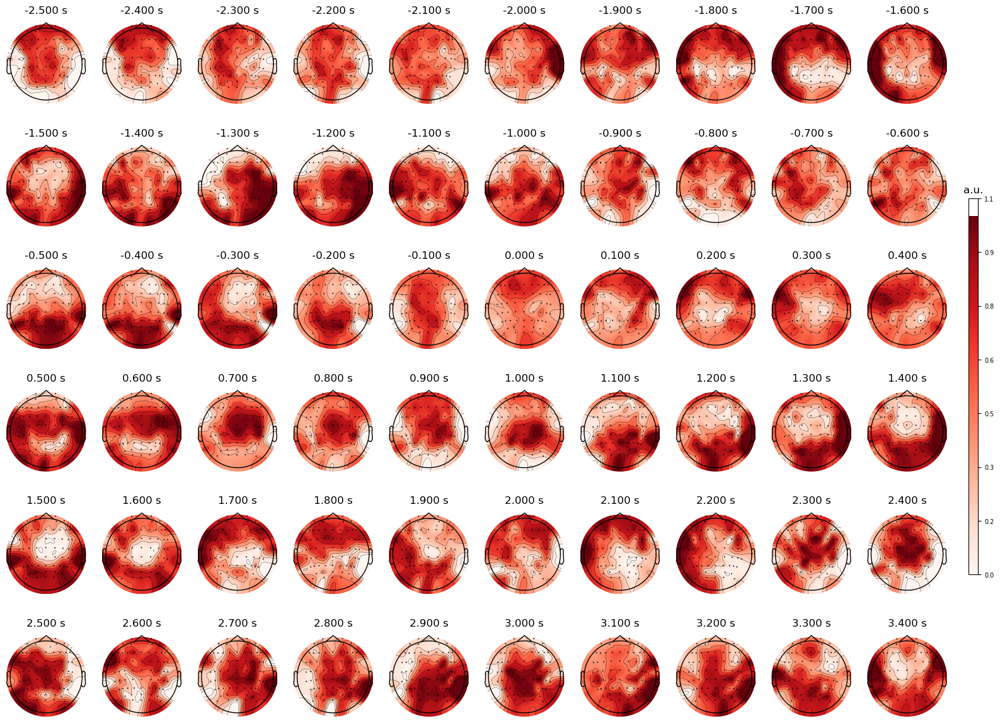

C:\Users\peter\AppData\Local\Temp\ipykernel_16696\290019963.py:6: RuntimeWarning: More than 25 topomaps plots requested. This might take a while.
  fig = p_ud_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',


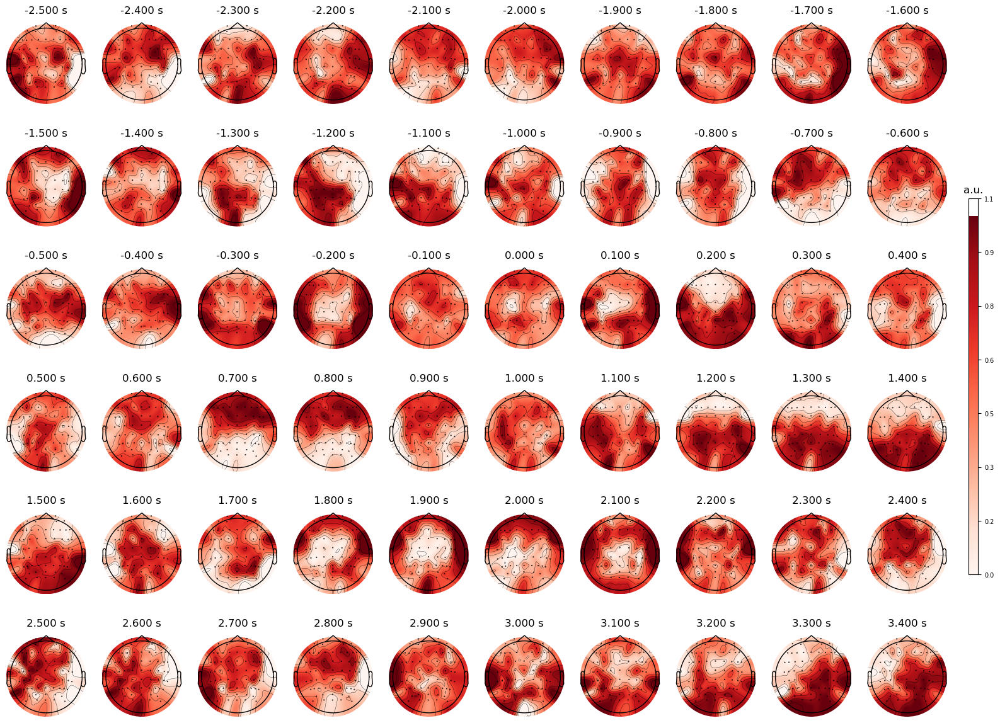

C:\Users\peter\AppData\Local\Temp\ipykernel_16696\290019963.py:10: RuntimeWarning: More than 25 topomaps plots requested. This might take a while.
  fig = p_ul_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',


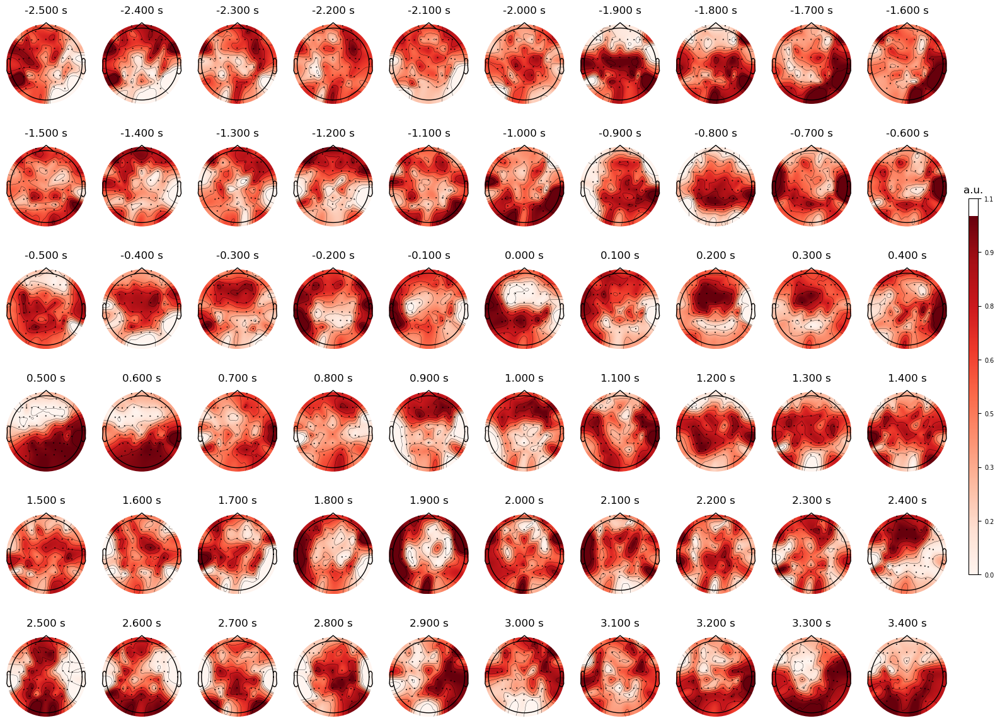

C:\Users\peter\AppData\Local\Temp\ipykernel_16696\290019963.py:14: RuntimeWarning: More than 25 topomaps plots requested. This might take a while.
  fig = p_ur_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',


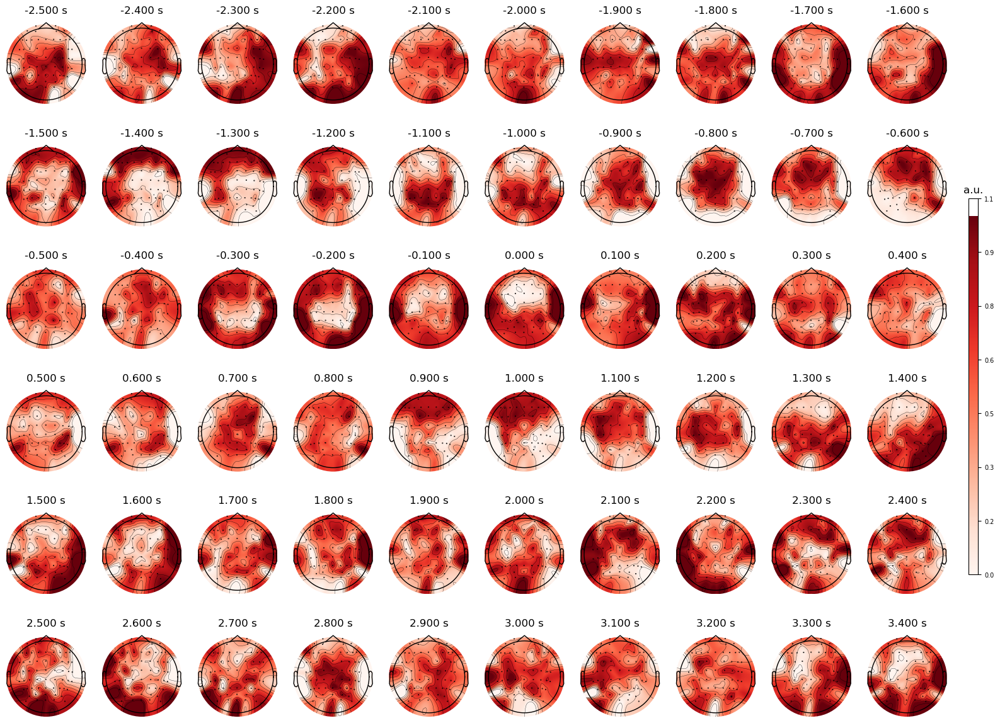

C:\Users\peter\AppData\Local\Temp\ipykernel_16696\290019963.py:18: RuntimeWarning: More than 25 topomaps plots requested. This might take a while.
  fig = p_dl_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',


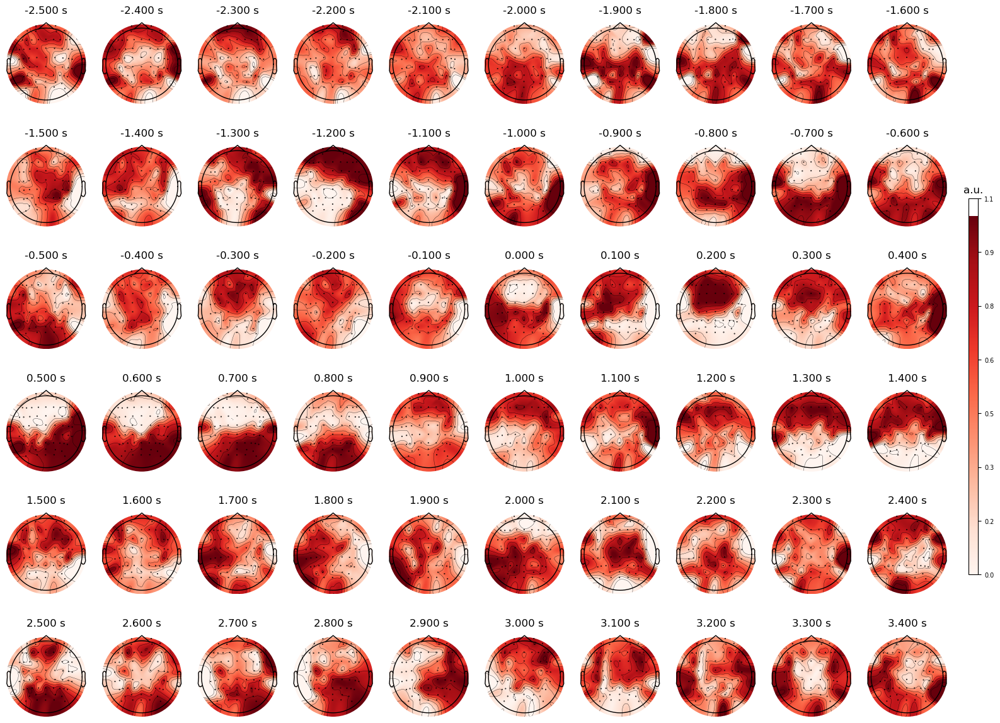

C:\Users\peter\AppData\Local\Temp\ipykernel_16696\290019963.py:22: RuntimeWarning: More than 25 topomaps plots requested. This might take a while.
  fig = p_dr_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',


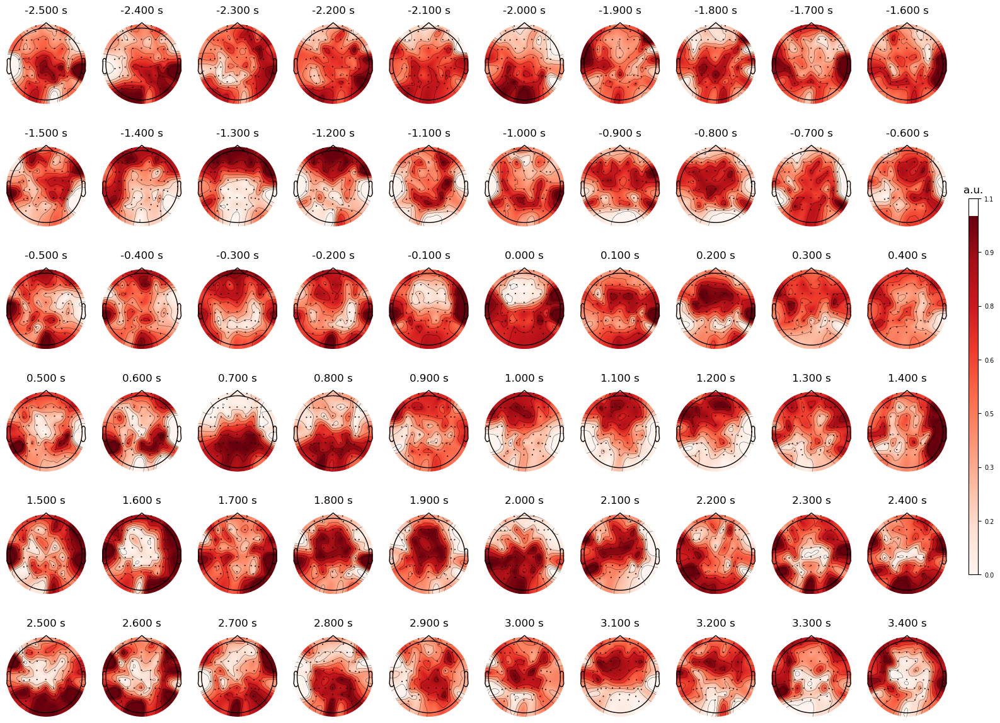

C:\Users\peter\AppData\Local\Temp\ipykernel_16696\290019963.py:26: RuntimeWarning: More than 25 topomaps plots requested. This might take a while.
  fig = p_lr_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',


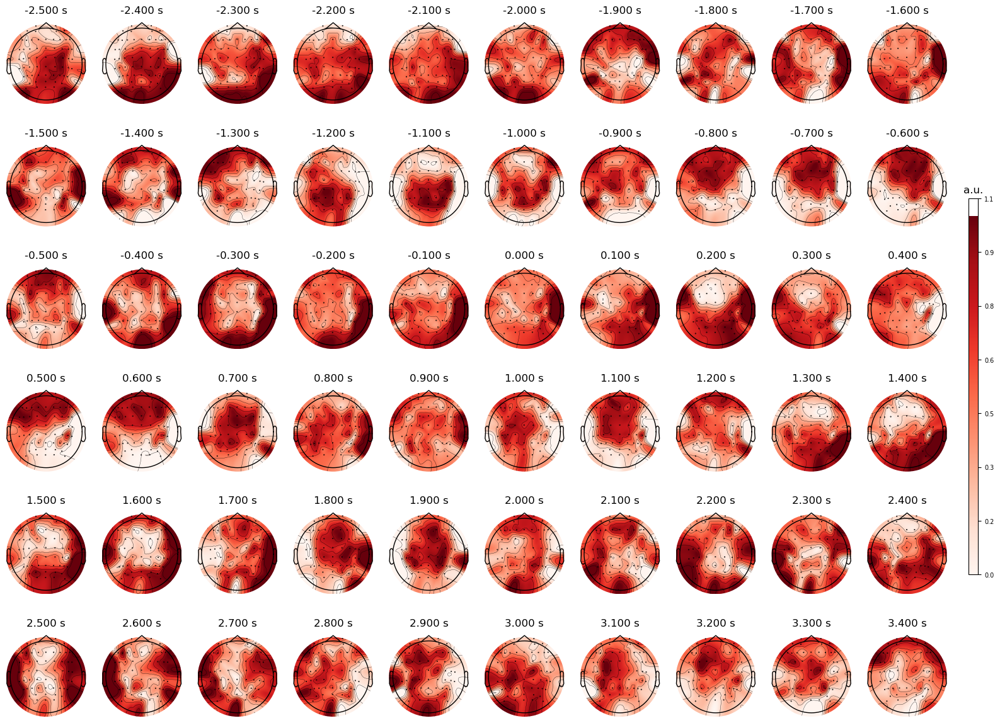

In [49]:
names = ['long_short', 'up_down', 'up_left', 'up_right', 'down_left', 'down_right', 'left_right']
fig = p_ls_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',
                                      vlim=(0, 1))
fig.savefig(f'{dst_path}/topomaps_combination_tested_{names[0]}_movement_aligned.png', dpi=400)

fig = p_ud_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',
                                      vlim=(0, 1))
fig.savefig(f'{dst_path}/topomaps_combination_tested_{names[1]}_movement_aligned.png', dpi=400)

fig = p_ul_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',
                                      vlim=(0, 1))
fig.savefig(f'{dst_path}/topomaps_combination_tested_{names[2]}_movement_aligned.png', dpi=400)

fig = p_ur_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',
                                      vlim=(0, 1))
fig.savefig(f'{dst_path}/topomaps_combination_tested_{names[3]}_movement_aligned.png', dpi=400)

fig = p_dl_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',
                                      vlim=(0, 1))
fig.savefig(f'{dst_path}/topomaps_combination_tested_{names[4]}_movement_aligned.png', dpi=400)

fig = p_dr_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',
                                      vlim=(0, 1))
fig.savefig(f'{dst_path}/topomaps_combination_tested_{names[5]}_movement_aligned.png', dpi=400)

fig = p_lr_epo.average().plot_topomap(list(times), ch_type='eeg', ncols=10, nrows='auto', scalings=dict(eeg=1), units='a.u.',
                                      vlim=(0, 1))
fig.savefig(f'{dst_path}/topomaps_combination_tested_{names[6]}_movement_aligned.png', dpi=400)

In [31]:
p_ls = np.squeeze(p_ls)